# Objective

Implement sytle transfer algorithm following the tutorial http://localhost:8891/notebooks/deep-learning-v2-pytorch/style-transfer/Style_Transfer_Solution.ipynb.

In this notebook, we’ll *recreate* a style transfer method that is outlined in the paper, [Image Style Transfer Using Convolutional Neural Networks, by Gatys](https://www.cv-foundation.org/openaccess/content_cvpr_2016/papers/Gatys_Image_Style_Transfer_CVPR_2016_paper.pdf) in PyTorch.

Data Source: https://www.kaggle.com/soumikrakshit/images-for-style-transfer for the style images, for the content images: self

# Setup

In [1]:
import os
import glob
import numpy as np

from PIL import Image
import matplotlib.pyplot as plt

import torch
from torch import nn, optim
from torch.utils.data import Dataset
from torchvision import datasets, transforms, models

# Plot the Images

In [15]:
style_folder = 'data/Artworks'
content_folder = 'data/Private2'

style_images = []
for file in glob.glob(os.path.join(style_folder,f'*')):
    style_images.append(file)

content_images = []
for file in glob.glob(os.path.join(content_folder,f'*')):
    content_images.append(file)

In [16]:
print(f'Number of style images: {len(style_images)}')
print(f'Number of content images: {len(content_images)}')

Number of style images: 35
Number of content images: 3


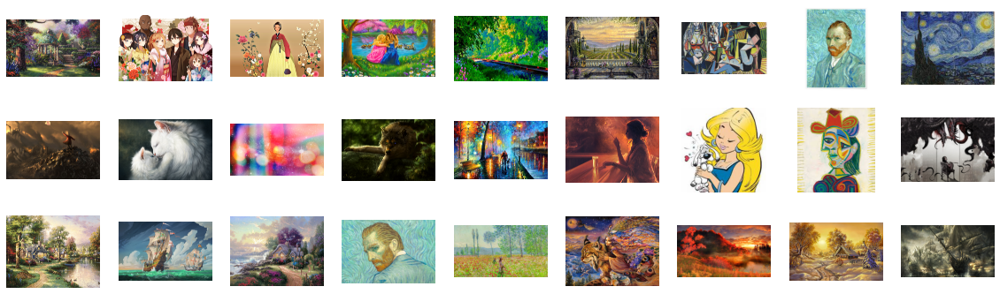

In [17]:
fig, axes = plt.subplots(3, 9, figsize=(20,6))
for i, ax in enumerate(axes.flatten()):
    ax.imshow(Image.open(style_images[i]).convert('RGB'))
    ax.set_axis_off()

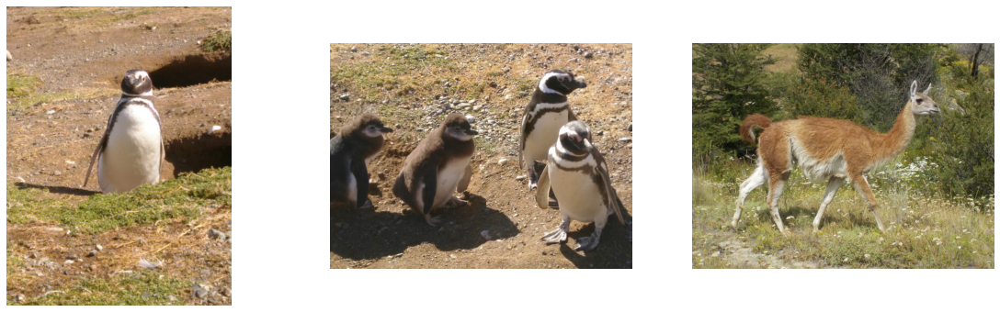

In [18]:
fig, axes = plt.subplots(1, 3, figsize=(20,6))
for i, ax in enumerate(axes.flatten()):
    ax.imshow(Image.open(content_images[i]).convert('RGB'))
    ax.set_axis_off()

# Set up the Model

In [19]:
class StyleModel(nn.Module):
    def __init__(self):
        super().__init__()
        # use VGG19 model
        self.vgg = models.vgg19(pretrained=True).features
        
        # freeze all VGG parameters
        for param in self.vgg.parameters():
            param.requires_grad_(False)
            
        print(self.vgg)
        
    def get_features(self, image, layers=None):
        ''' To get the content and style representations of an image, 
         we have to pass an image forward throug the VGG19 network 
         until we get to the desired layer(s) and then get the output from that layer.
         
         Run an image forward through a model and get the features for 
        a set of layers. Default layers are for VGGNet matching Gatys et al (2016)
        '''
        ## Need the layers for the content and style representations of an image
        if layers is None:
            layers = {'0': 'conv1_1',
                      '5': 'conv2_1', 
                      '10': 'conv3_1', 
                      '19': 'conv4_1',
                      '21': 'conv4_2',  ## content representation
                      '28': 'conv5_1'}
            
        # we have to pass an image forward through the VGG19 network 
        # until we get to the desired layer(s) and then get the output from that layer.
            
        features = {}
        x = image
        # self.vgg._modules is a dictionary holding each module in the model
        for name, layer in self.vgg._modules.items():
            x = layer(x)
            if name in layers:
                features[layers[name]] = x
        
        return features
    
    
    def forward(self, style_image, content_image, target_image):
        # get style and content features
        style_features = self.get_features(style_image, layers=None)
        content_features = self.get_features(content_image, layers=None)
        target_features = self.get_features(target_image, layers=None)
        
        return style_features, content_features, target_features

In [20]:
model = StyleModel()
#model

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

# Read and prepare the Images

In [21]:
# read data
style_images = []
for file in glob.glob(os.path.join(style_folder,f'*')):
    style_images.append(file)

content_images = []
for file in glob.glob(os.path.join(content_folder,f'*')):
    content_images.append(file)

torch.Size([1, 3, 400, 600])
torch.Size([1, 3, 400, 600])


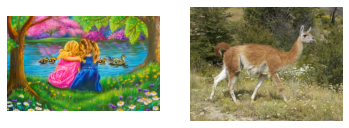

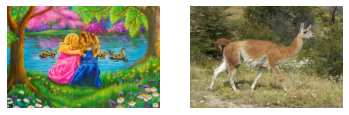

In [24]:
# choose a random content and style image
style_image_path = style_images[3]#[np.random.randint(len(style_images))]
content_image_path = content_images[2]# [np.random.randint(len(content_images))]

style_image = Image.open(style_image_path)
content_image = Image.open(content_image_path)

# define transforms
img_transforms = transforms.Compose([transforms.Resize([400,600]), 
                                 transforms.ToTensor(),
                                 transforms.Normalize((0.485, 0.456, 0.406), 
                                                      (0.229, 0.224, 0.225))])

        
fig, axes = plt.subplots(1, 2)
axes[0].imshow(style_image)
axes[0].set_axis_off()
axes[1].imshow(content_image)
axes[1].set_axis_off()
# apply transforms to images
style_image = img_transforms(style_image)[None,...]
content_image = img_transforms(content_image)[None,...]
print(style_image.shape)
print(content_image.shape)

# helper function for un-normalizing an image 
# and converting it from a Tensor image to a NumPy image for display
def im_convert(tensor):
    """ Display a tensor as an image. """
    
    image = tensor.detach()#.to("cpu").clone().detach()
    image = image.numpy().squeeze()
    image = image.transpose(1,2,0)
    image = image * np.array((0.229, 0.224, 0.225)) + np.array((0.485, 0.456, 0.406))
    image = image.clip(0, 1)

    return image


fig, axes = plt.subplots(1, 2)
axes[0].imshow(im_convert(style_image))
axes[0].set_axis_off()
axes[1].imshow(im_convert(content_image))
axes[1].set_axis_off()

In [25]:
def gram_matrix(tensor):
    '''The output of every convolutional layer is a Tensor with dimensions associated with 
        the batch_size, a depth, d and some height and width (h, w). 
        The Gram matrix of a convolutional layer can be calculated as follows:

        * Get the depth, height, and width of a tensor using batch_size, d, h, w = tensor.size
        * Reshape that tensor so that the spatial dimensions are flattened
        * Calculate the gram matrix by multiplying the reshaped tensor by it's transpose'''
        
    batch_size, d, h, w = tensor.size()
    tensor = tensor.view(d, h*w)
    gram = torch.mm(tensor, tensor.t())
        
    return gram

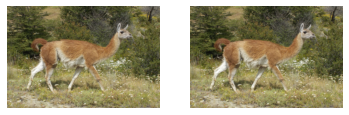

In [26]:
# create a third "target" image and prep it for change
# it is a good idea to start off with the target as a copy of our *content* image
# then iteratively change its style

target_image = content_image.clone().requires_grad_(True)#.to(device)

fig, axes = plt.subplots(1, 2)
axes[0].imshow(im_convert(target_image))
axes[0].set_axis_off()
axes[1].imshow(im_convert(content_image))
axes[1].set_axis_off()

In [27]:
output = model(style_image=style_image, content_image=content_image, target_image=target_image)
print(f'output length: {len(output)}')
print(f'style_image: {output[0].keys()}')
print(f'content_image: {output[1].keys()}')
print(f'target_image: {output[1].keys()}')

/home/frauke/anaconda3/envs/torchvision/lib/python3.9/site-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /opt/conda/conda-bld/pytorch_1623448222085/work/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


output length: 3
style_image: dict_keys(['conv1_1', 'conv2_1', 'conv3_1', 'conv4_1', 'conv4_2', 'conv5_1'])
content_image: dict_keys(['conv1_1', 'conv2_1', 'conv3_1', 'conv4_1', 'conv4_2', 'conv5_1'])
target_image: dict_keys(['conv1_1', 'conv2_1', 'conv3_1', 'conv4_1', 'conv4_2', 'conv5_1'])


# Loss and Weights

#### Individual Layer Style Weights

Weight the style representation at each relevant layer. It's suggested to use a range between 0-1 to weight these layers. By weighting earlier layers (`conv1_1` and `conv2_1`) more, you can expect to get _larger_ style artifacts in your resulting, target image. Should you choose to weight later layers, you'll get more emphasis on smaller features. This is because each layer is a different size and together they create a multi-scale style representation!

#### Content and Style Weight

We define a `content_weight` and a `style_weight`. This ratio will affect how _stylized_ your final image is. It's recommended that you leave the content_weight = 1 and set the style_weight to achieve the ratio you want.

In [28]:
# weights for each style layer 
# weighting earlier layers more will result in *larger* style artifacts
# notice we are excluding `conv4_2` our content representation
style_weights = {'conv1_1': 3.5,
                 'conv2_1': 2.75,
                 'conv3_1': 0.2,
                 'conv4_1': 0.2,
                 'conv5_1': 0.2}

content_weight = 1  # alpha
style_weight = 1e6  # beta

In [29]:
#optimizer = optim.Adam(model.parameters(), lr=.001)
optimizer = optim.Adam([target_image], lr=.001)

# iterate a number of steps (compares to training) to generate target image
steps = 4000
show_every = 400

def style_transfer(style_image=style_image,content_image=content_image, target_image=target_image, steps=steps, show_every=400, optimizer=optimizer):
    for step in range(steps):
    
        output = model(style_image=style_image, content_image=content_image, target_image=target_image)

        style_features = output[0]
        content_features = output[1]
        target_features = output[2]
        
        # calculate the gram matrices for each layer of our style representation
        style_grams = {layer: gram_matrix(style_features[layer]) for layer in style_features}
        # the content loss
        content_loss = torch.mean((target_features['conv4_2'] - content_features['conv4_2'])**2)
    
    
        # initialze style loss
        style_loss = 0
        for layer in style_weights:
            # target feature for layer
            target_feature = target_features[layer]
            target_gram = gram_matrix(target_feature)
            _, d, h, w = target_feature.shape
            style_gram = style_grams[layer]
            # the style loss for one layer, weighted appropriately
            layer_style_loss = style_weights[layer] * torch.mean((target_gram - style_gram)**2)
            # add to the style loss
            style_loss += layer_style_loss / (d * h * w)
    
    
        # calculate the *total* loss
        total_loss = content_weight * content_loss + style_weight * style_loss

    
        # update target image
        optimizer.zero_grad()
        total_loss.backward()
        optimizer.step()
    
        # display intermediate images and print the loss
        if  step % show_every == 0:
            print(f'Content loss: {content_loss:.4f}')
            print(f'Style loss: {style_loss:.4f}')
            print(f'Total loss: {total_loss:.4f}')
            plt.imshow(im_convert(target_image))
            plt.axis('off')
            plt.show()

Content loss: 0.0000
Style loss: 1579.5336
Total loss: 1579533568.0000


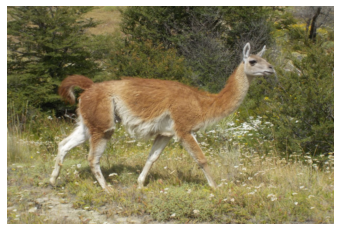

Content loss: 4.6863
Style loss: 608.6897
Total loss: 608689728.0000


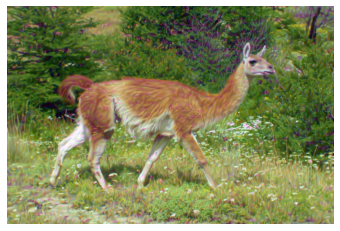

Content loss: 6.1305
Style loss: 301.6113
Total loss: 301611264.0000


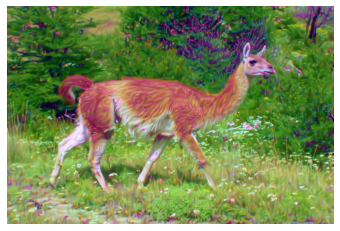

Content loss: 6.9284
Style loss: 137.2571
Total loss: 137257104.0000


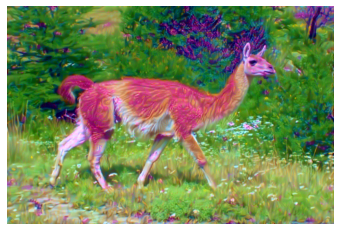

Content loss: 7.4835
Style loss: 60.4488
Total loss: 60448852.0000


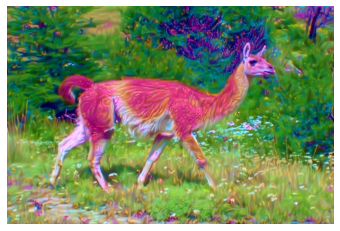

Content loss: 7.9187
Style loss: 27.9115
Total loss: 27911552.0000


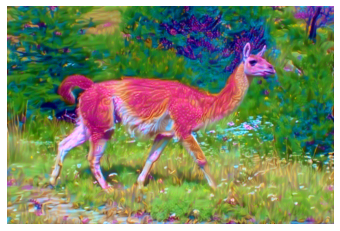

Content loss: 8.2319
Style loss: 16.7424
Total loss: 16742457.0000


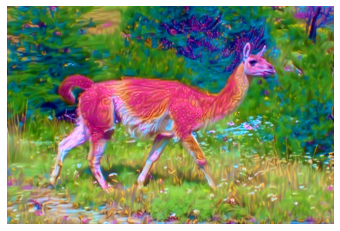

Content loss: 8.4618
Style loss: 12.0382
Total loss: 12038198.0000


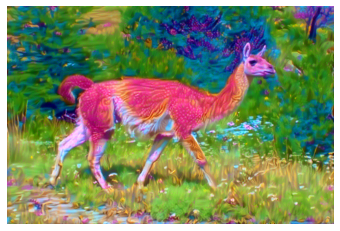

Content loss: 8.6574
Style loss: 9.2697
Total loss: 9269662.0000


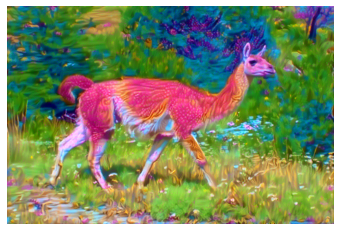

Content loss: 8.8308
Style loss: 7.2379
Total loss: 7237897.0000


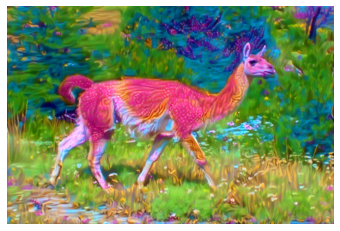

In [30]:
style_transfer(style_image=style_image,content_image=content_image, target_image=target_image, steps=steps, show_every=400, optimizer=optimizer)

# Save Plots

In [24]:
def saveplots(content_image, style_image, target_image, name="guanaco"):
    fig, axis = plt.subplots(1, 3, figsize=(15,5))
    axis[0].imshow(im_convert(style_image))
    axis[0].axis('off')
    axis[1].imshow(im_convert(content_image))
    axis[1].axis('off')
    axis[2].imshow(im_convert(target_image))
    axis[2].axis('off')
    plt.savefig(f'data/ConstructedImages/{name}.png')
    plt.show()

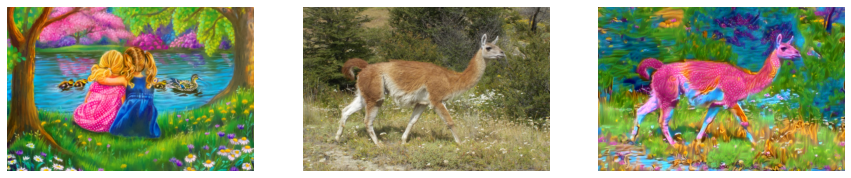

In [20]:
saveplots(content_image, style_image, target_image, name="guanaco")

In [25]:
def saveplot_target(style_image, name="guanaco_target"):
    plt.imshow(im_convert(target_image))
    plt.axis('off')
    plt.savefig(f'data/ConstructedImages/{name}.png')
    plt.show()

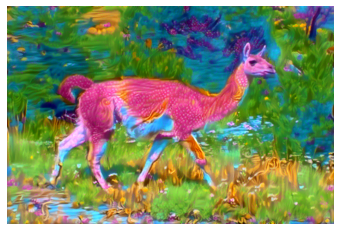

In [22]:
saveplot_target(style_image, name="guanaco_target")

# More Examples

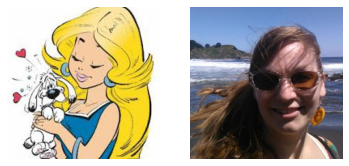

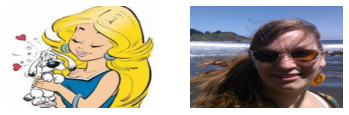

In [59]:
# choose content and style image
style_image_path = style_images[14]
content_image_path = content_images[9]

style_image = Image.open(style_image_path)
content_image = Image.open(content_image_path)
fig, axes = plt.subplots(1, 2)
axes[0].imshow(style_image)
axes[0].set_axis_off()
axes[1].imshow(content_image)
axes[1].set_axis_off()
# apply transforms to images
style_image = img_transforms(style_image)[None,...]
content_image = img_transforms(content_image)[None,...]


fig, axes = plt.subplots(1, 2)
axes[0].imshow(im_convert(style_image))
axes[0].set_axis_off()
axes[1].imshow(im_convert(content_image))
axes[1].set_axis_off()

target_image = content_image.clone().requires_grad_(True)

Content loss: 0.0140
Style loss: 826.0825
Total loss: 826082432.0000


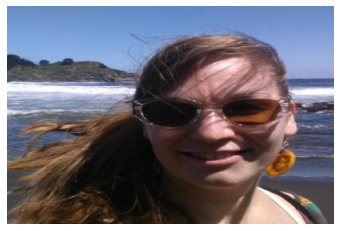

Content loss: 3.5584
Style loss: 416.7637
Total loss: 416763680.0000


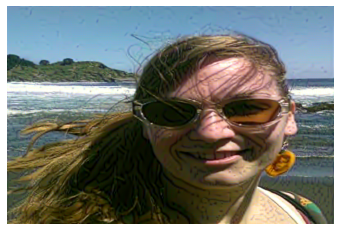

Content loss: 4.6192
Style loss: 309.5662
Total loss: 309566208.0000


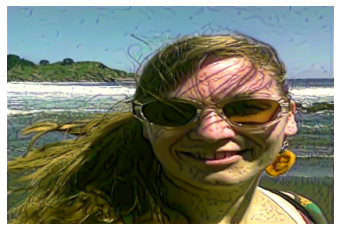

Content loss: 5.2287
Style loss: 244.6231
Total loss: 244623072.0000


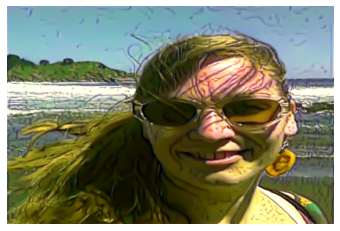

Content loss: 5.6827
Style loss: 191.5223
Total loss: 191522304.0000


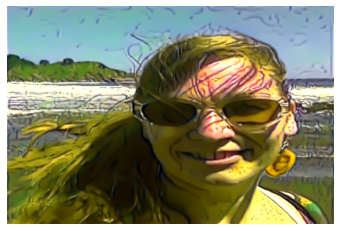

Content loss: 6.0541
Style loss: 146.0466
Total loss: 146046608.0000


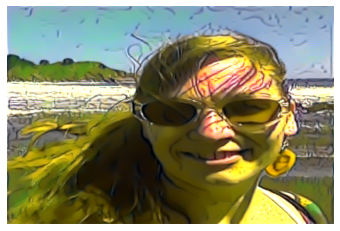

Content loss: 6.3280
Style loss: 108.7938
Total loss: 108793816.0000


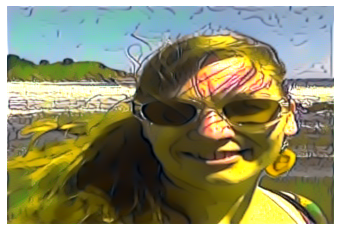

Content loss: 6.5264
Style loss: 81.0604
Total loss: 81060392.0000


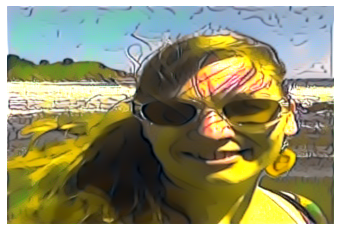

Content loss: 6.7089
Style loss: 62.0215
Total loss: 62021472.0000


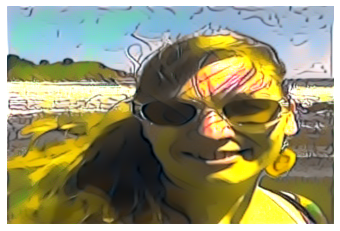

Content loss: 6.8983
Style loss: 48.9039
Total loss: 48903892.0000


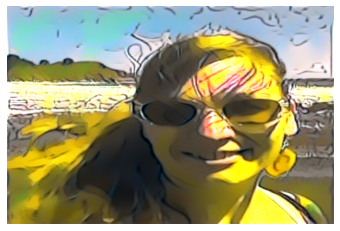

In [62]:
optimizer = optim.Adam([target_image], lr=.001)
steps = 4000
show_every = 400
style_transfer(style_image=style_image,content_image=content_image, target_image=target_image, steps=steps, show_every=400, optimizer=optimizer)

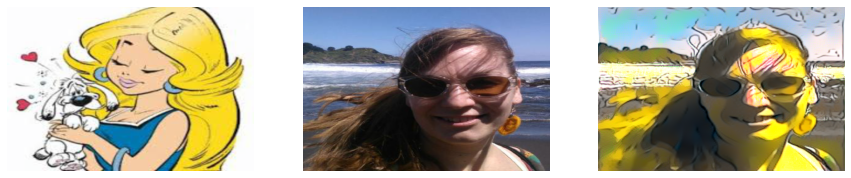

In [63]:
saveplots(content_image, style_image, target_image, name="comic")

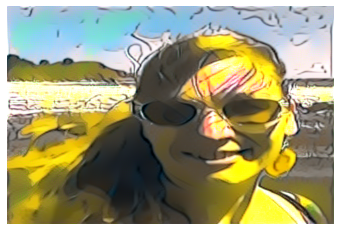

In [64]:
saveplot_target(style_image, name="comic_target")

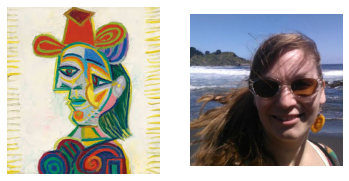

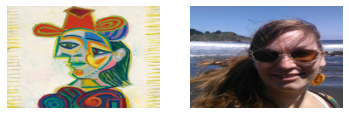

In [189]:
# choose a content and style image
style_image_path = style_images[16]
content_image_path = content_images[9]

style_image = Image.open(style_image_path)
content_image = Image.open(content_image_path)
fig, axes = plt.subplots(1, 2)
axes[0].imshow(style_image)
axes[0].set_axis_off()
axes[1].imshow(content_image)
axes[1].set_axis_off()
# apply transforms to images
style_image = img_transforms(style_image)[None,...]
content_image = img_transforms(content_image)[None,...]


fig, axes = plt.subplots(1, 2)
axes[0].imshow(im_convert(style_image))
axes[0].set_axis_off()
axes[1].imshow(im_convert(content_image))
axes[1].set_axis_off()

target_image = content_image.clone().requires_grad_(True)

Content loss: 0.2648
Style loss: 924.0241
Total loss: 924024128.0000


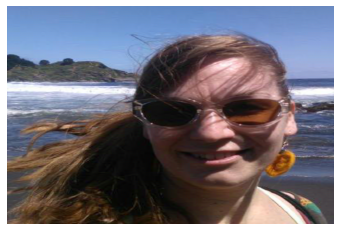

Content loss: 3.2030
Style loss: 188.3804
Total loss: 188380416.0000


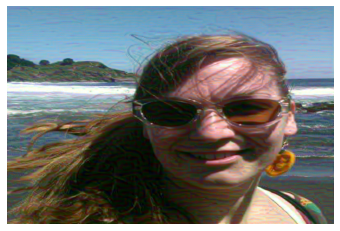

Content loss: 4.0447
Style loss: 119.6385
Total loss: 119638512.0000


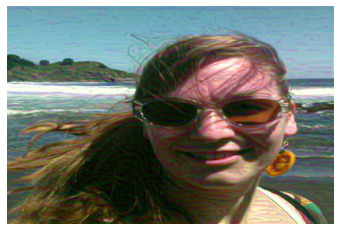

Content loss: 4.4505
Style loss: 91.9790
Total loss: 91978984.0000


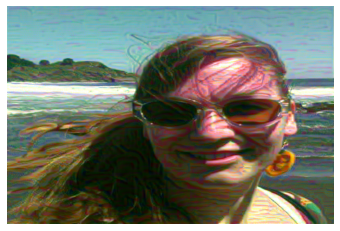

Content loss: 4.7545
Style loss: 75.2605
Total loss: 75260488.0000


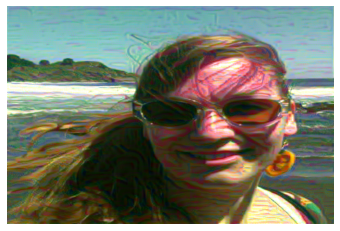

Content loss: 5.0013
Style loss: 62.6826
Total loss: 62682620.0000


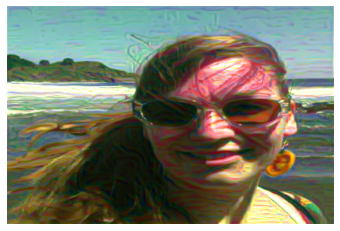

Content loss: 5.2108
Style loss: 52.2679
Total loss: 52267904.0000


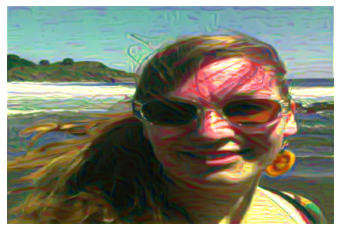

Content loss: 5.3848
Style loss: 43.5667
Total loss: 43566660.0000


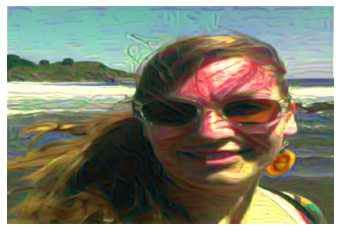

Content loss: 5.5545
Style loss: 36.4258
Total loss: 36425780.0000


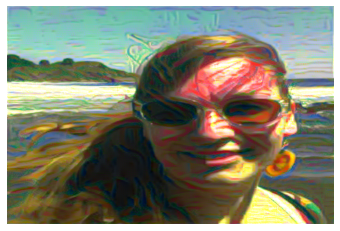

Content loss: 5.6949
Style loss: 30.6560
Total loss: 30655998.0000


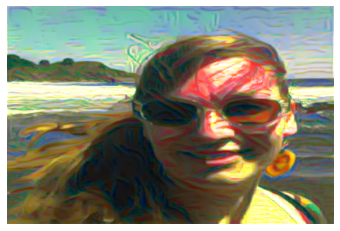

In [191]:
optimizer = optim.Adam([target_image], lr=.001)
steps = 4000
show_every = 400
style_transfer(style_image=style_image, content_image=content_image, target_image=target_image, steps=steps, show_every=400, optimizer=optimizer)

Content loss: 5.8081
Style loss: 25.9346
Total loss: 25934562.0000


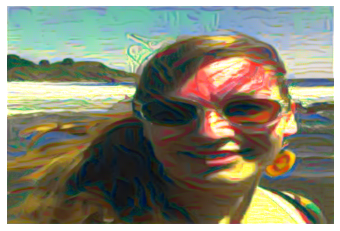

Content loss: 5.9140
Style loss: 22.0164
Total loss: 22016386.0000


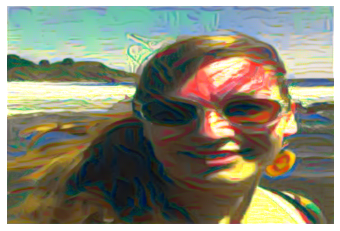

Content loss: 6.0079
Style loss: 18.6770
Total loss: 18677012.0000


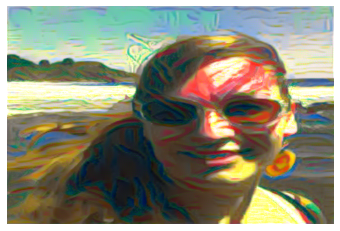

Content loss: 6.0884
Style loss: 15.7534
Total loss: 15753404.0000


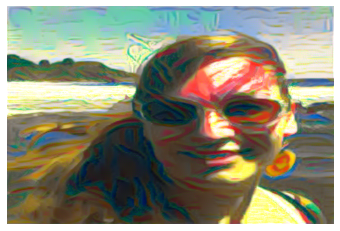

Content loss: 6.1602
Style loss: 13.1434
Total loss: 13143448.0000


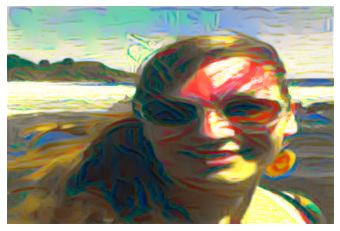

Content loss: 6.2270
Style loss: 10.8301
Total loss: 10830118.0000


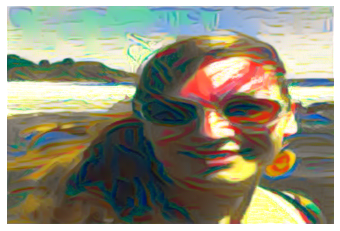

Content loss: 6.2766
Style loss: 8.8082
Total loss: 8808252.0000


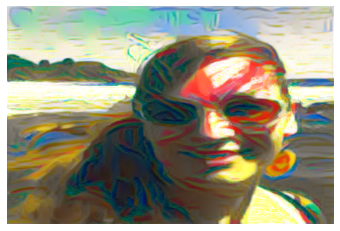

Content loss: 6.3260
Style loss: 7.0754
Total loss: 7075430.5000


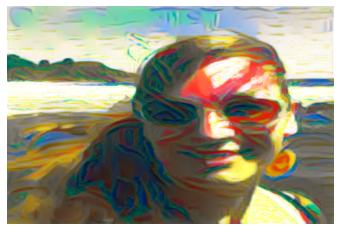

Content loss: 6.3738
Style loss: 5.6564
Total loss: 5656418.5000


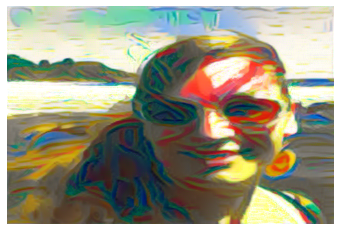

Content loss: 6.4238
Style loss: 4.5226
Total loss: 4522617.0000


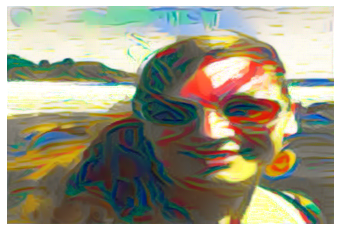

In [192]:
style_transfer(style_image=style_image, content_image=content_image, target_image=target_image, steps=steps, show_every=400, optimizer=optimizer)

Content loss: 6.4597
Style loss: 3.6408
Total loss: 3640842.2500


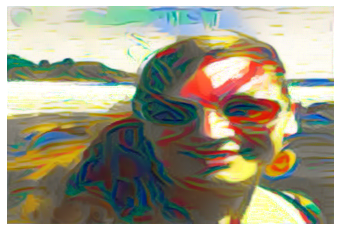

Content loss: 6.4921
Style loss: 2.9598
Total loss: 2959836.0000


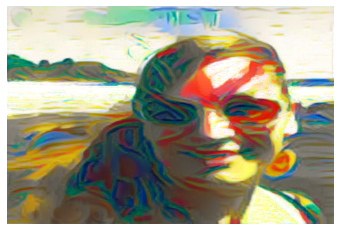

Content loss: 6.5310
Style loss: 2.4323
Total loss: 2432280.2500


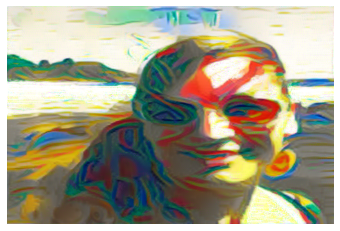

Content loss: 6.5747
Style loss: 2.0150
Total loss: 2015009.1250


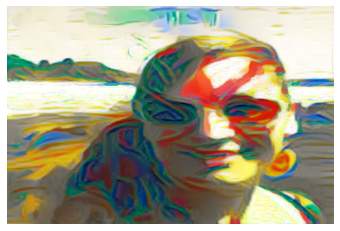

Content loss: 6.6132
Style loss: 1.6840
Total loss: 1683961.7500


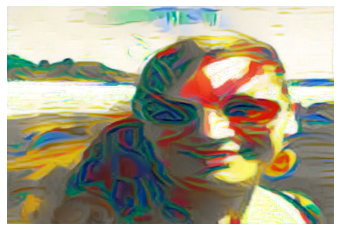

Content loss: 6.6478
Style loss: 1.4173
Total loss: 1417353.3750


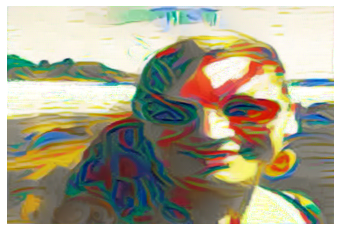

Content loss: 6.6895
Style loss: 1.1991
Total loss: 1199142.3750


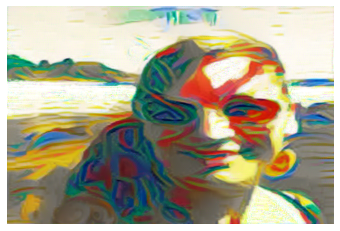

Content loss: 6.7236
Style loss: 1.0192
Total loss: 1019164.5000


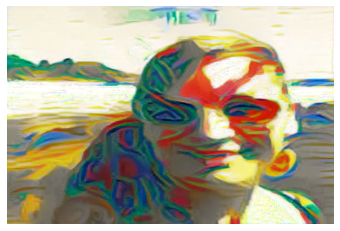

Content loss: 6.7609
Style loss: 0.8728
Total loss: 872809.0625


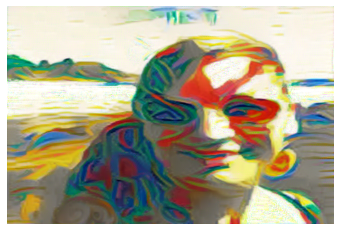

Content loss: 6.7986
Style loss: 0.7532
Total loss: 753229.4375


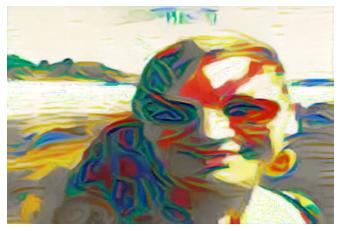

In [195]:
style_transfer(style_image=style_image, content_image=content_image, target_image=target_image, steps=steps, show_every=400, optimizer=optimizer)

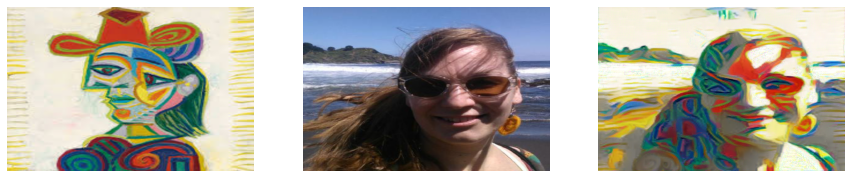

In [196]:
saveplots(content_image, style_image, target_image, name="pcasso")

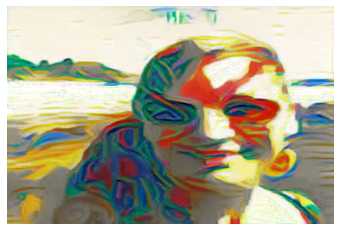

In [197]:
saveplot_target(style_image, name="picasso_target")

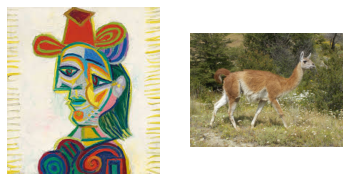

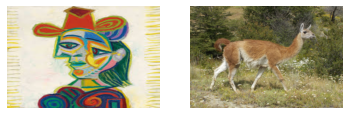

In [20]:
# choose a content and style image
style_image_path = style_images[16]
content_image_path = content_images[6]

style_image = Image.open(style_image_path)
content_image = Image.open(content_image_path)
fig, axes = plt.subplots(1, 2)
axes[0].imshow(style_image)
axes[0].set_axis_off()
axes[1].imshow(content_image)
axes[1].set_axis_off()
# apply transforms to images
style_image = img_transforms(style_image)[None,...]
content_image = img_transforms(content_image)[None,...]


fig, axes = plt.subplots(1, 2)
axes[0].imshow(im_convert(style_image))
axes[0].set_axis_off()
axes[1].imshow(im_convert(content_image))
axes[1].set_axis_off()

target_image = content_image.clone().requires_grad_(True)

Content loss: 0.0006
Style loss: 1162.4320
Total loss: 1162432000.0000


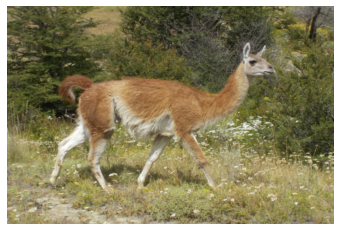

Content loss: 4.0140
Style loss: 230.2759
Total loss: 230275888.0000


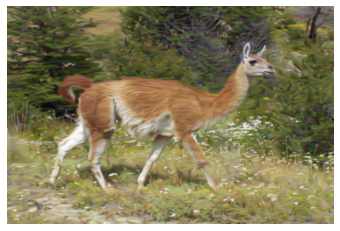

Content loss: 5.1412
Style loss: 164.2969
Total loss: 164296896.0000


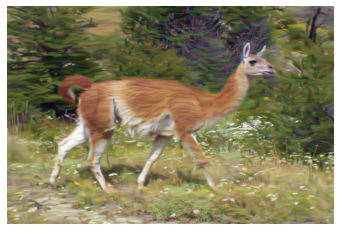

Content loss: 5.7206
Style loss: 131.4662
Total loss: 131466168.0000


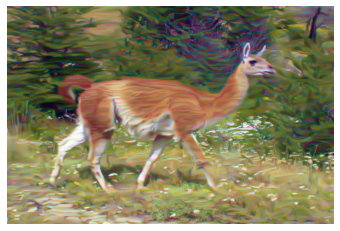

Content loss: 6.0743
Style loss: 106.9402
Total loss: 106940184.0000


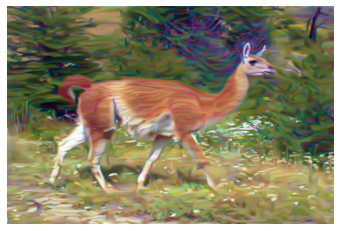

Content loss: 6.3435
Style loss: 87.4073
Total loss: 87407320.0000


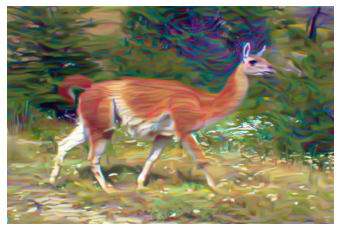

Content loss: 6.5639
Style loss: 72.3731
Total loss: 72373136.0000


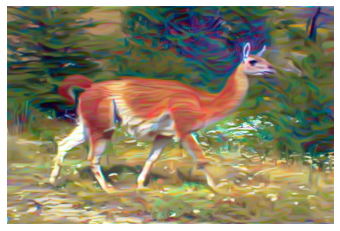

Content loss: 6.7552
Style loss: 60.9025
Total loss: 60902496.0000


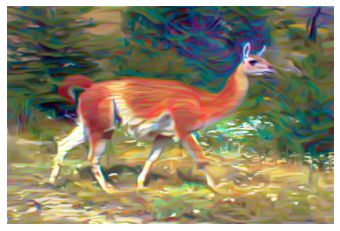

Content loss: 6.9399
Style loss: 51.5396
Total loss: 51539568.0000


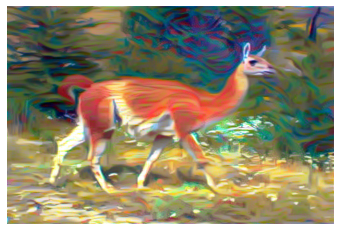

Content loss: 7.1026
Style loss: 43.4611
Total loss: 43461100.0000


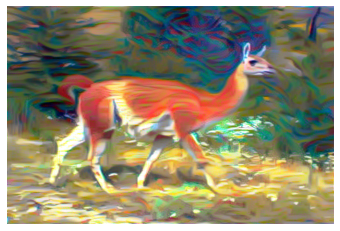

In [22]:
optimizer = optim.Adam([target_image], lr=.001)
steps = 4000
show_every = 400
style_transfer(style_image=style_image, content_image=content_image, target_image=target_image, steps=steps, show_every=400, optimizer=optimizer)

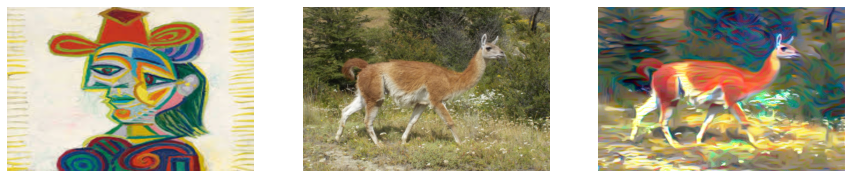

In [26]:
saveplots(content_image, style_image, target_image, name="picasso_guanaco")

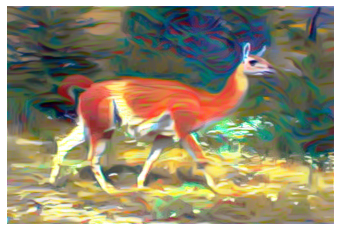

In [27]:
saveplot_target(style_image, name="picasso_guanaco_target")

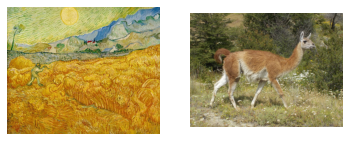

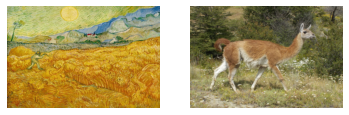

In [64]:
# choose a content and style image
style_image_path = style_images[34]
content_image_path = content_images[6]

style_image = Image.open(style_image_path)
content_image = Image.open(content_image_path)
fig, axes = plt.subplots(1, 2)
axes[0].imshow(style_image)
axes[0].set_axis_off()
axes[1].imshow(content_image)
axes[1].set_axis_off()
# apply transforms to images
style_image = img_transforms(style_image)[None,...]
content_image = img_transforms(content_image)[None,...]


fig, axes = plt.subplots(1, 2)
axes[0].imshow(im_convert(style_image))
axes[0].set_axis_off()
axes[1].imshow(im_convert(content_image))
axes[1].set_axis_off()

target_image = content_image.clone().requires_grad_(True)

Content loss: 0.0004
Style loss: 743.5409
Total loss: 743540864.0000


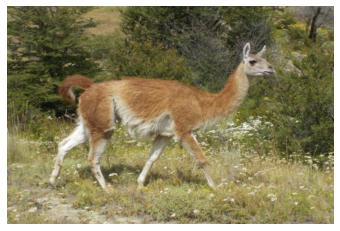

Content loss: 2.4952
Style loss: 172.1726
Total loss: 172172624.0000


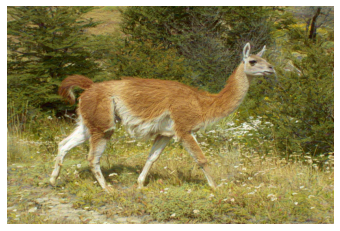

Content loss: 3.3166
Style loss: 77.7422
Total loss: 77742248.0000


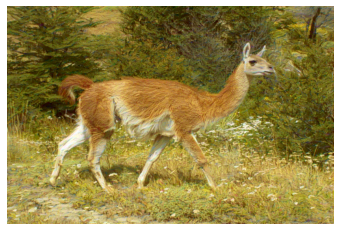

Content loss: 3.7946
Style loss: 35.6867
Total loss: 35686736.0000


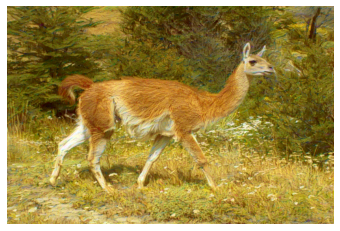

Content loss: 4.1344
Style loss: 18.7780
Total loss: 18778016.0000


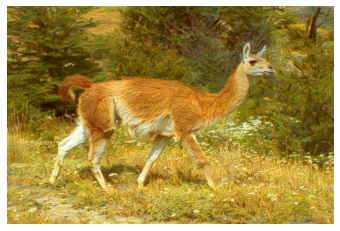

Content loss: 4.4057
Style loss: 11.7482
Total loss: 11748249.0000


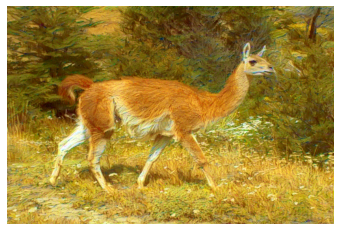

Content loss: 4.6319
Style loss: 8.2041
Total loss: 8204059.5000


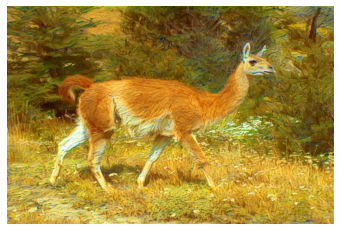

Content loss: 4.8125
Style loss: 6.1056
Total loss: 6105570.5000


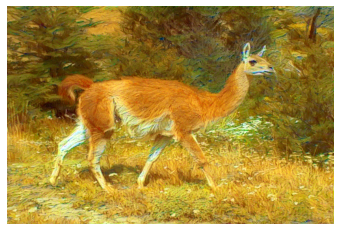

Content loss: 4.9599
Style loss: 4.7277
Total loss: 4727667.0000


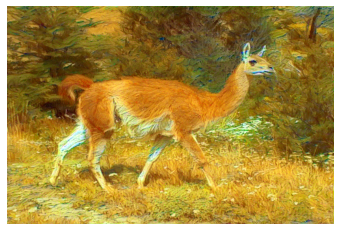

Content loss: 5.0916
Style loss: 3.7385
Total loss: 3738537.0000


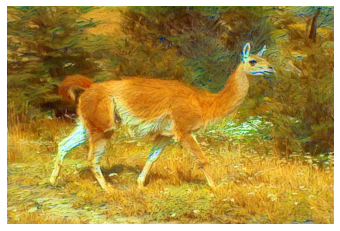

In [66]:
optimizer = optim.Adam([target_image], lr=.001)
steps = 4000
show_every = 400
style_transfer(style_image=style_image, content_image=content_image, target_image=target_image, steps=steps, show_every=400, optimizer=optimizer)

Content loss: 5.2072
Style loss: 2.9809
Total loss: 2980879.0000


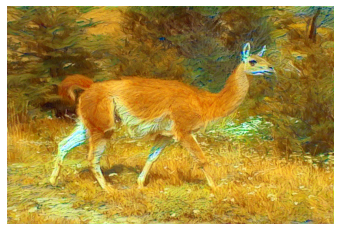

Content loss: 5.3149
Style loss: 2.3917
Total loss: 2391719.0000


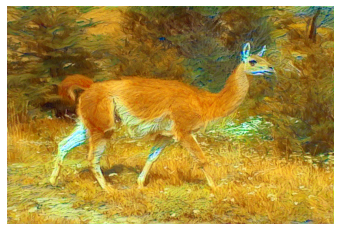

Content loss: 5.4141
Style loss: 1.9380
Total loss: 1938034.2500


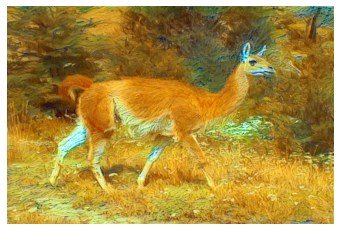

Content loss: 5.4989
Style loss: 1.5813
Total loss: 1581325.0000


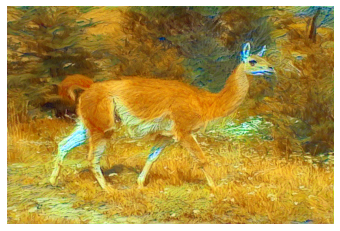

Content loss: 5.5765
Style loss: 1.2886
Total loss: 1288566.3750


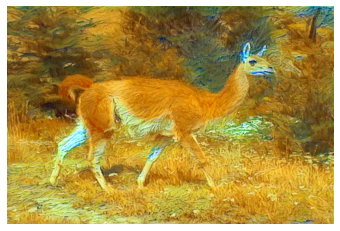

Content loss: 5.6517
Style loss: 1.0414
Total loss: 1041429.5625


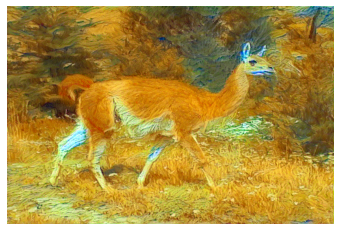

Content loss: 5.7268
Style loss: 0.8327
Total loss: 832677.5625


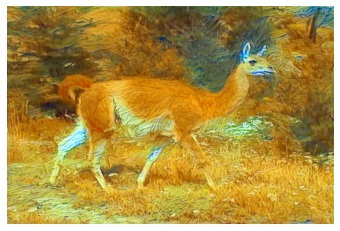

Content loss: 5.7928
Style loss: 0.6587
Total loss: 658743.8125


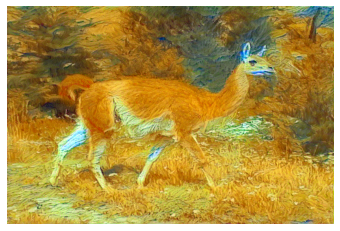

Content loss: 5.8522
Style loss: 0.5170
Total loss: 516975.0938


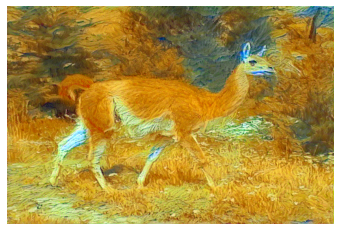

Content loss: 5.9161
Style loss: 0.4039
Total loss: 403861.3750


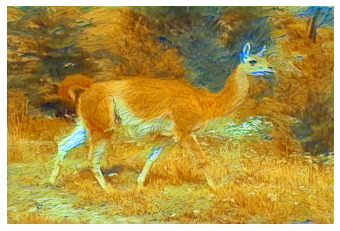

In [69]:
style_transfer(style_image=style_image, content_image=content_image, target_image=target_image, steps=steps, show_every=400, optimizer=optimizer)

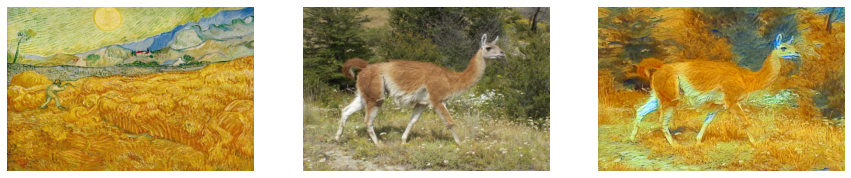

In [70]:
saveplots(content_image, style_image, target_image, name="van_gogh_guanaco")

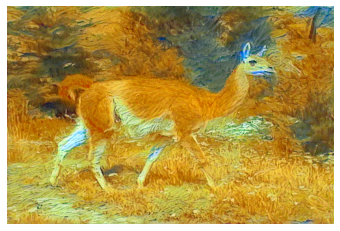

In [71]:
saveplot_target(style_image, name="van_gogh_guanaco_target")